In [1]:
### Visualization of clustering results in UMAP

# Load Libraries

In [2]:
import scanpy as sc
import anndata as an
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import scanorama
import os
import multiprocessing
import random
import time
import git
import sys
from datetime import date

# Load Data

## Configurations

### Technical configurations

In [3]:
multiprocessing.cpu_count()  ### total amount of cpu on the used core

96

In [4]:
len(os.sched_getaffinity(0)) ### amount of available cpus

24

In [5]:
sc.settings.n_jobs   # default number of CPUs to use for parallel computing

1

In [6]:
sc.settings.max_memory  # maximum memory to use in GB

15

In [7]:
random.seed(7)

In [8]:
ncore = '24'

In [9]:
random_state_var = 7

In [10]:
n_jobs_var = 24

In [11]:
os.environ["OMP_NUM_THREADS"] = ncore
os.environ["OPENBLAS_NUM_THREADS"] = ncore
os.environ["MKL_NUM_THREADS"] = ncore
os.environ["VECLIB_MAXIMUM_THREADS"] = ncore
os.environ["NUMEXPR_NUM_THREADS"] = ncore

In [12]:
sc.logging.print_versions()
sc.set_figure_params(facecolor="white", figsize=(8, 8))
sc.settings.verbosity = 0

The `sinfo` package has changed name and is now called `session_info` to become more discoverable and self-explanatory. The `sinfo` PyPI package will be kept around to avoid breaking old installs and you can downgrade to 0.3.2 if you want to use it without seeing this message. For the latest features and bug fixes, please install `session_info` instead. The usage and defaults also changed slightly, so please review the latest README at https://gitlab.com/joelostblom/session_info.
-----
anndata     0.7.6
scanpy      1.8.1
sinfo       0.3.4
-----
PIL                 8.3.1
annoy               NA
anyio               NA
attr                21.2.0
babel               2.9.1
backcall            0.2.0
beta_ufunc          NA
binom_ufunc         NA
brotli              NA
certifi             2021.05.30
cffi                1.14.6
chardet             4.0.0
charset_normalizer  2.0.0
cycler              0.10.0
cython_runtime      NA
dateutil            2.8.2
decorator           5.0.9
defusedxml       

In [13]:
file_name = 'B2_V3_Scanorama_Singlets_Clustering_Visualization_and_Annotation_P2_further_investigations.ipynb'

In [14]:
repo = git.Repo('stark-stemi')

### Parameters

In [15]:
data_path = '../data/current'

In [16]:
data_path

'../data/current'

In [17]:
variants = ['V1_All'] 

In [18]:
result_path = '../results/current'

In [19]:
### Dataset storing annotations

In [20]:
saved_annotations = pd.read_csv(result_path + '/B-Analysis/saved_annotations.csv')

In [21]:
result_path = '../results/current'

In [22]:
### Dataset storing annotations

## Meta-Data File

In [23]:
path = data_path + "/preprocessed-data/meta-data/Mapping_Hashtag_Sample.csv"
library_hashtag_mapping = pd.read_csv(path) 

In [24]:
#library_hashtag_mapping

## Clustered data from B2 Scanorama

In [25]:
anndata_dict = dict.fromkeys(variants)

In [26]:
for key in anndata_dict:
    dataset_path = data_path + '/analysis/B/B2_Integrated_Scanorama_Singlet_processed_rna.h5ad'
    
    print(dataset_path)
    print('Last modified' + time.ctime(os.path.getmtime(dataset_path)))
    
    adata_orig = sc.read_h5ad(dataset_path)
    anndata_dict[key]= adata_orig # save anndata in dictionary
    
    anndata_dict[key].uns['data_load_time'] = time.ctime(os.path.getmtime(dataset_path))  # save the last modified timestamp of the data loaded
    anndata_dict[key].uns['data_load_name'] = dataset_path # save the data path of the data loaded 
    

../data/current/analysis/B/B2_Integrated_Scanorama_Singlet_processed_rna.h5ad
Last modifiedSat Jan 21 09:41:55 2023


In [27]:
### Short data check

In [28]:
# anndata_dict['V1_All']  # cells have been filtered only on singlets

In [29]:
anndata_dict['V1_All'].X.sum(axis=1) # data was normalized and log-transformed


matrix([[21.065617],
        [25.584118],
        [21.224699],
        ...,
        [22.754984],
        [29.788113],
        [23.377083]], dtype=float32)

## Azimuth cell-type annotations for comparison

In [30]:
path = data_path + '/analysis/G/G2_Cell_Annotations_Azimuth.csv'
azimuth_annotation = pd.read_csv(path) 

In [34]:
azimuth_annotation['cell_name'] = azimuth_annotation['cell'] + '-' + azimuth_annotation['library']

In [43]:
azimuth_annotation.index = azimuth_annotation['cell_name']

In [44]:
azimuth_annotation

,Unnamed: 0,nCount_RNA,nFeature_RNA,predicted.celltype.l2,predicted.celltype.l2.score,library,cell,cell_name
cell_name,,,,,,,,
AAACCCACATACAGGG-1-L1,AAACCCACATACAGGG-1,3947,1232,B memory,0.966819,L1,AAACCCACATACAGGG-1,AAACCCACATACAGGG-1-L1
AAACCCACATGACTTG-1-L1,AAACCCACATGACTTG-1,5871,1890,CD16 Mono,1.000000,L1,AAACCCACATGACTTG-1,AAACCCACATGACTTG-1-L1
AAACCCAGTCATCAGT-1-L1,AAACCCAGTCATCAGT-1,3889,1297,CD4 TCM,0.761811,L1,AAACCCAGTCATCAGT-1,AAACCCAGTCATCAGT-1-L1
AAACCCAGTGGTAATA-1-L1,AAACCCAGTGGTAATA-1,5094,1327,CD4 TCM,0.948890,L1,AAACCCAGTGGTAATA-1,AAACCCAGTGGTAATA-1-L1
AAACCCATCATCACAG-1-L1,AAACCCATCATCACAG-1,17480,2363,Plasmablast,1.000000,L1,AAACCCATCATCACAG-1,AAACCCATCATCACAG-1-L1
...,...,...,...,...,...,...,...,...
TTTGTTGCAGGTTCGC-1-L14,TTTGTTGCAGGTTCGC-1,8451,2433,CD4 TCM,0.405543,L14,TTTGTTGCAGGTTCGC-1,TTTGTTGCAGGTTCGC-1-L14
TTTGTTGGTACCTAGT-1-L14,TTTGTTGGTACCTAGT-1,7125,1743,CD4 TEM,0.749416,L14,TTTGTTGGTACCTAGT-1,TTTGTTGGTACCTAGT-1-L14
TTTGTTGGTACGTTCA-1-L14,TTTGTTGGTACGTTCA-1,4079,1412,CD14 Mono,1.000000,L14,TTTGTTGGTACGTTCA-1,TTTGTTGGTACGTTCA-1-L14


# Data Adaptions

In [36]:
### convert scrublet doublet predictions to string for visualization

for key in anndata_dict:
    
    ## convert to inspect in string
    anndata_dict[key].obs['A5_scrublet_predicted_doublet_lib0.2'] =anndata_dict[key].obs['A5_scrublet_predicted_doublet_lib0.2'].apply(str)

In [37]:
### add binarized columns
for key in anndata_dict:
    
    ## convert to inspect in string
    anndata_dict[key].obs =anndata_dict[key].obs.join(pd.get_dummies(anndata_dict[key].obs['library_id']))
    anndata_dict[key].obs =anndata_dict[key].obs.join(pd.get_dummies(anndata_dict[key].obs['group']))

In [45]:
### Merge Azimuht annotation

In [52]:
sum(azimuth_annotation.index == anndata_dict['V1_All'].obs.index)

148275

In [54]:
anndata_dict['V1_All'].obs['azimuth_annotation'] = azimuth_annotation['predicted.celltype.l2']

In [64]:
anndata_dict['V1_All']

AnnData object with n_obs × n_vars = 148275 × 2000
    obs: 'nCount_HTO', 'nFeature_HTO', 'nCount_RNA', 'nFeature_RNA', 'percent_mt', 'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification', 'HTO_classification.global', 'hash.ID', 'HTO_classification_final', 'name', 'library', 'id', 'read', 'pattern', 'sequence', 'feature_type', 'Unnamed: 7', 'in_sample', 'display_name', 'group', 'HTO_Doublet_Classification', 'doublet_score', 'predicted_doublet', 'A5_scrublet_predicted_doublet_lib0.1', 'A5_scrublet_doublet_score_lib_0.1', 'A5_scrublet_predicted_doublet_lib0.2', 'A5_scrublet_doublet_score_lib_0.2', 'A5_scrublet_predicted_doublet_lib', 'A5_scrublet_doublet_score_lib', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'valid_cell_filter_dying', 'valid_cell_filter_doublet', 'A7_PCA_50_10_neighbors_cluster', 'A7_PCA_100_10_neighbors_cluster', 'A7_PCA_100_50_neighbors_cluster', 'A7_PCA_500_50_neighbors_cluster', 'A7_Singlet_PCA_50_10_neighbors_cluste

In [55]:
#azimuth_annotation

In [57]:
#anndata_dict['V1_All'].obs

# Visualize Clustering results

In [58]:
#anndata_dict

In [59]:
### Define UMAPs for visualization

In [60]:
used_umap_list = { 'V2': 'X_umapB2_Scanorama_Singlet_rb_mt'}

In [61]:
used_neighbors_key_list = { 'V2':'B2_Scanorama_Singlet_rb_mt'} 

## Azimuth Annotation

Library: V1_All
X_umapB2_Scanorama_Singlet_rb_mt


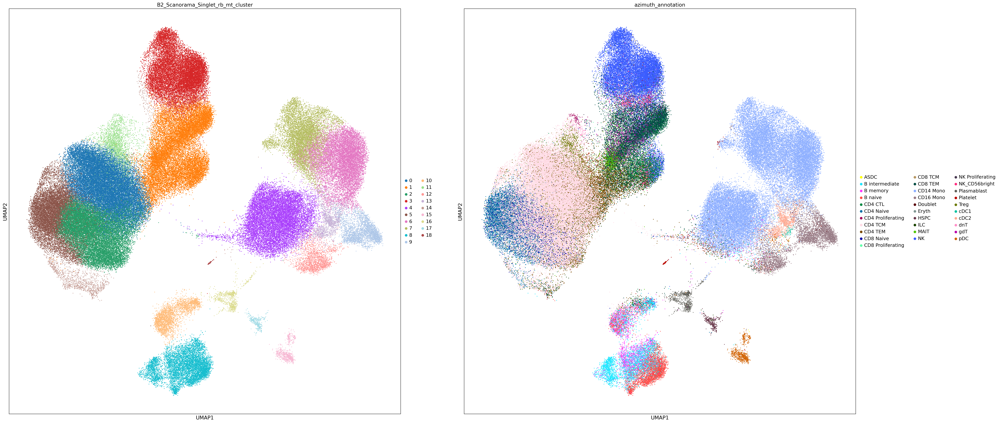

In [65]:
### Plot the resulting clusters for each library

sc.set_figure_params(dpi=100, color_map = 'viridis_r')
plt.rcParams['figure.figsize'] = [20, 20] 

for key in anndata_dict:
    print('Library: ' + key)
    
    for umap in used_umap_list:
        used_umap = used_umap_list[umap]
        used_neighbors_key = used_neighbors_key_list[umap]
        print(used_umap)
        anndata_dict[key].obsm['X_umap'] = anndata_dict[key].obsm[used_umap]
        
        sc.pl.umap(anndata_dict[key], color=['B2_Scanorama_Singlet_rb_mt_cluster','azimuth_annotation'], s = 15, ncols = 2, neighbors_key = used_neighbors_key)
        #sc.pl.umap(anndata_dict[key], color=['ALL_PCA_50_10_neighbors_cluster','ALL_PCA_100_10_neighbors_cluster','library_id', 'group', 'HTO_classification_final', 'total_counts', 'HTO_classification.global',  'A5_scrublet_doublet_score_lib_0.2', 'A5_scrublet_predicted_doublet_lib0.2'], s = 10, ncols = 2, neighbors_key = used_neighbors_key)
    
    print('')
    
    print ('')

## Batch Effects

Library: V1_All
X_umapB2_Scanorama_Singlet_rb_mt


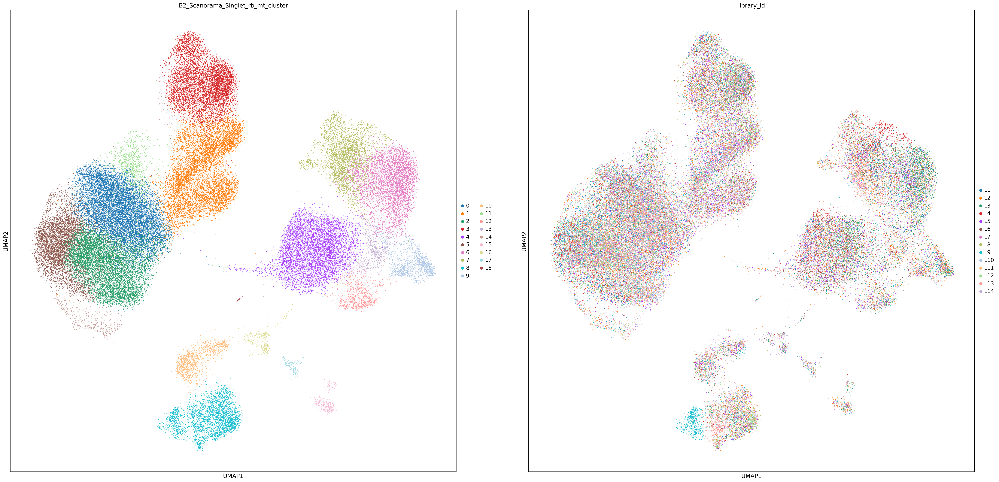

In [41]:
### Plot the resulting clusters for each library

sc.set_figure_params(dpi=100, color_map = 'viridis_r')
plt.rcParams['figure.figsize'] = [20, 20] 

for key in anndata_dict:
    print('Library: ' + key)
    
    for umap in used_umap_list:
        used_umap = used_umap_list[umap]
        used_neighbors_key = used_neighbors_key_list[umap]
        print(used_umap)
        anndata_dict[key].obsm['X_umap'] = anndata_dict[key].obsm[used_umap]
        
        sc.pl.umap(anndata_dict[key], color=['B2_Scanorama_Singlet_rb_mt_cluster','library_id'], s = 5, ncols = 2, neighbors_key = used_neighbors_key)
        #sc.pl.umap(anndata_dict[key], color=['ALL_PCA_50_10_neighbors_cluster','ALL_PCA_100_10_neighbors_cluster','library_id', 'group', 'HTO_classification_final', 'total_counts', 'HTO_classification.global',  'A5_scrublet_doublet_score_lib_0.2', 'A5_scrublet_predicted_doublet_lib0.2'], s = 10, ncols = 2, neighbors_key = used_neighbors_key)
    
    print('')
    ### Interesting parameters
    # use_raw = true - what to use for coloring with gene expression; default true if layer is not provided
    # layer = name of layer that should be plotted
    # neighbors_key = where to look for neighbors connectivities
    
    print ('')

## Investigate distribution for single libs

Library: V1_All
X_umapB2_Scanorama_Singlet_rb_mt


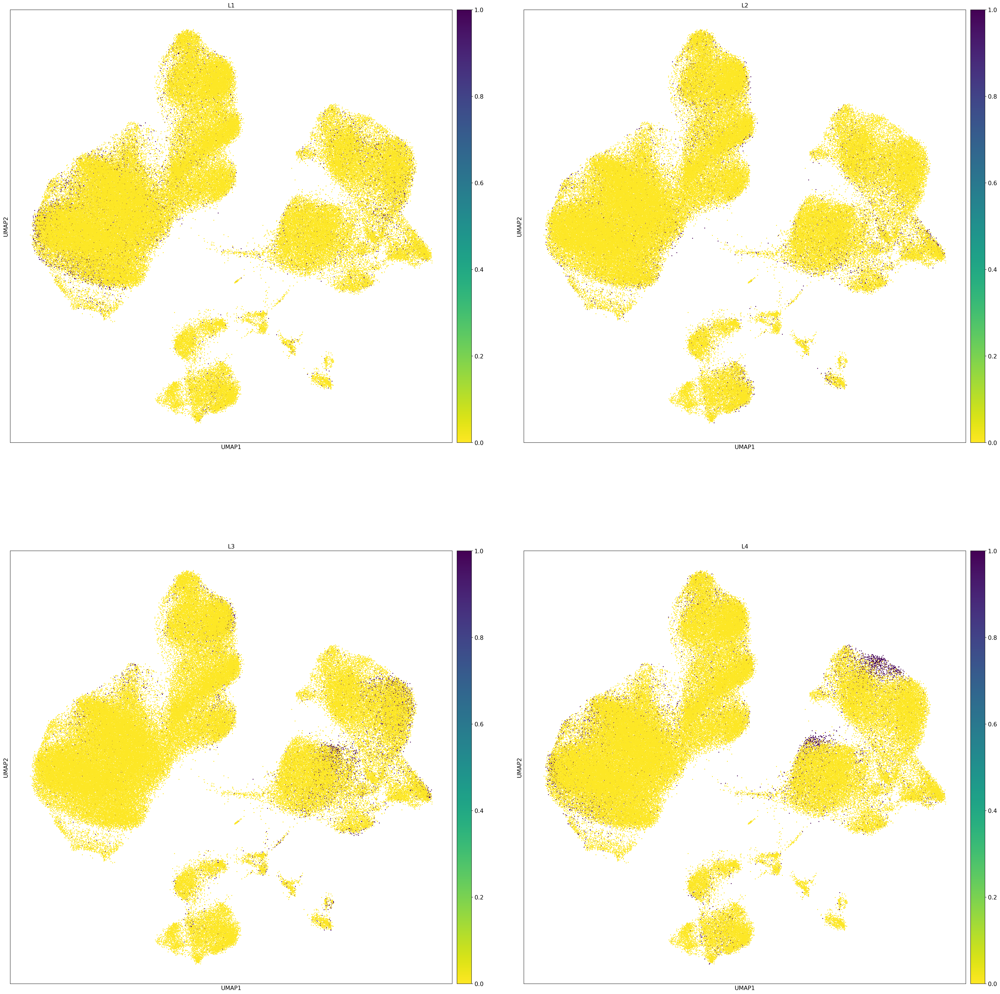

In [42]:
### Check out distribution across Libs

sc.set_figure_params(dpi=100, color_map = 'viridis_r')
plt.rcParams['figure.figsize'] = [20, 20] 

for key in anndata_dict:
    print('Library: ' + key)
    
    for umap in used_umap_list:
        used_umap = used_umap_list[umap]
        used_neighbors_key = used_neighbors_key_list[umap]
        print(used_umap)
        anndata_dict[key].obsm['X_umap'] = anndata_dict[key].obsm[used_umap]
        
        sc.pl.umap(anndata_dict[key], color=['L1', 'L2', 'L3', 'L4'], s = 20, ncols = 2, neighbors_key = used_neighbors_key)
        #sc.pl.umap(anndata_dict[key], color=['ALL_PCA_50_10_neighbors_cluster','ALL_PCA_100_10_neighbors_cluster','library_id', 'group', 'HTO_classification_final', 'total_counts', 'HTO_classification.global',  'A5_scrublet_doublet_score_lib_0.2', 'A5_scrublet_predicted_doublet_lib0.2'], s = 10, ncols = 2, neighbors_key = used_neighbors_key)
    
    print('')
    ### Interesting parameters
    # use_raw = true - what to use for coloring with gene expression; default true if layer is not provided
    # layer = name of layer that should be plotted
    # neighbors_key = where to look for neighbors connectivities
    
    print ('')

Library: V1_All
X_umapB2_Scanorama_Singlet_rb_mt


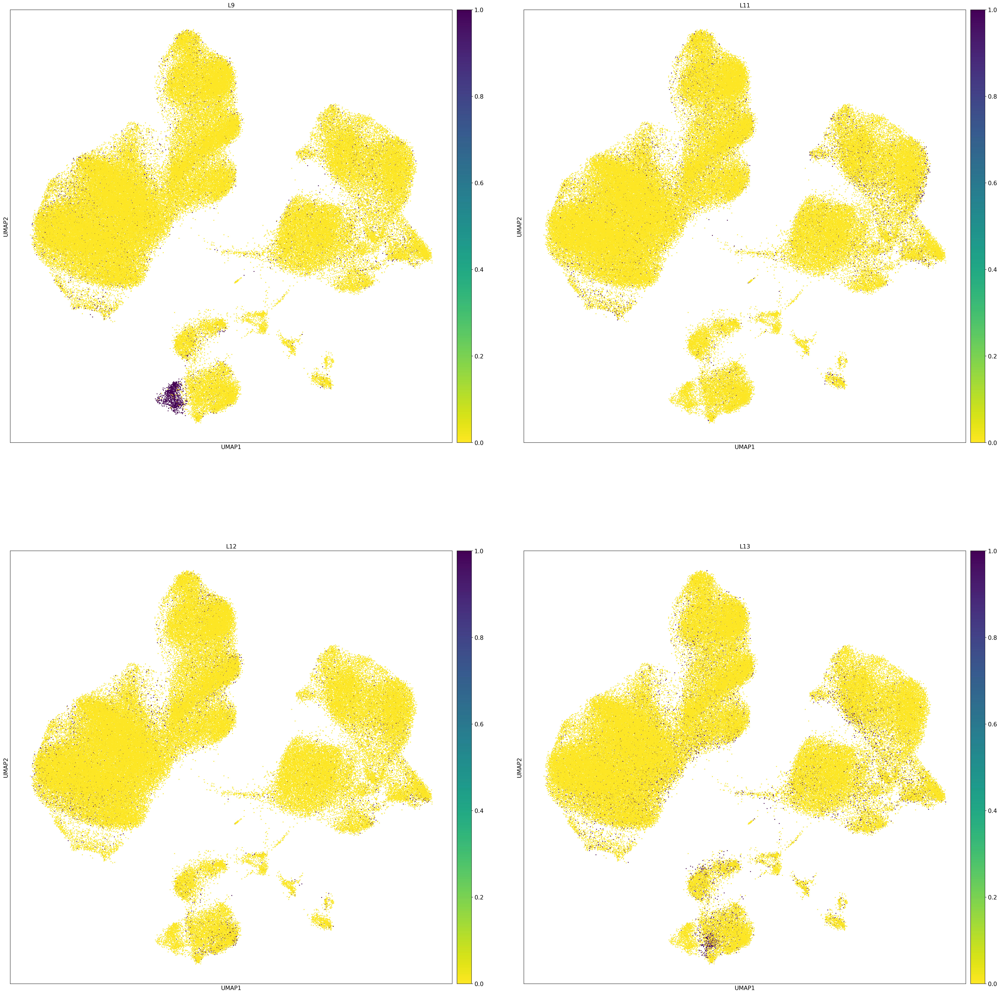

In [43]:
### Check out distribution across Libs

sc.set_figure_params(dpi=100, color_map = 'viridis_r')
plt.rcParams['figure.figsize'] = [20, 20] 

for key in anndata_dict:
    print('Library: ' + key)
    
    for umap in used_umap_list:
        used_umap = used_umap_list[umap]
        used_neighbors_key = used_neighbors_key_list[umap]
        print(used_umap)
        anndata_dict[key].obsm['X_umap'] = anndata_dict[key].obsm[used_umap]
        
        sc.pl.umap(anndata_dict[key], color=['L9', 'L11', 'L12', 'L13'], s = 20, ncols = 2, neighbors_key = used_neighbors_key)
        #sc.pl.umap(anndata_dict[key], color=['ALL_PCA_50_10_neighbors_cluster','ALL_PCA_100_10_neighbors_cluster','library_id', 'group', 'HTO_classification_final', 'total_counts', 'HTO_classification.global',  'A5_scrublet_doublet_score_lib_0.2', 'A5_scrublet_predicted_doublet_lib0.2'], s = 10, ncols = 2, neighbors_key = used_neighbors_key)
    
    print('')
    ### Interesting parameters
    # use_raw = true - what to use for coloring with gene expression; default true if layer is not provided
    # layer = name of layer that should be plotted
    # neighbors_key = where to look for neighbors connectivities
    
    print ('')

### Check out distribution for single groups

In [ ]:
### Check out distribution across Libs

sc.set_figure_params(dpi=100, color_map = 'viridis_r')
plt.rcParams['figure.figsize'] = [20, 20] 

for key in anndata_dict:
    print('Library: ' + key)
    
    for umap in used_umap_list:
        used_umap = used_umap_list[umap]
        used_neighbors_key = used_neighbors_key_list[umap]
        print(used_umap)
        anndata_dict[key].obsm['X_umap'] = anndata_dict[key].obsm[used_umap]
        
        sc.pl.umap(anndata_dict[key], color=['No-CCS', 'Chronic-CCS', 'TP1', 'TP2', 'TP3', 'TP4'], s = 20, ncols = 2, neighbors_key = used_neighbors_key)
        #sc.pl.umap(anndata_dict[key], color=['ALL_PCA_50_10_neighbors_cluster','ALL_PCA_100_10_neighbors_cluster','library_id', 'group', 'HTO_classification_final', 'total_counts', 'HTO_classification.global',  'A5_scrublet_doublet_score_lib_0.2', 'A5_scrublet_predicted_doublet_lib0.2'], s = 10, ncols = 2, neighbors_key = used_neighbors_key)
    
    print('')
    ### Interesting parameters
    # use_raw = true - what to use for coloring with gene expression; default true if layer is not provided
    # layer = name of layer that should be plotted
    # neighbors_key = where to look for neighbors connectivities
    
    print ('')

Library: V1_All
X_umapB2_Scanorama_Singlet_rb_mt


### Check out distribution for single samples

In [52]:
### Samples: 26, 28, 33, 34 of lib 9 are the ones without CCS

### Doublet Effects

In [ ]:
### Plot the resulting clusters for each library

sc.set_figure_params(dpi=100, color_map = 'viridis_r')
plt.rcParams['figure.figsize'] = [20, 20] 

for key in anndata_dict:
    print('Library: ' + key)
    
    for umap in used_umap_list:
        used_umap = used_umap_list[umap]
        used_neighbors_key = used_neighbors_key_list[umap]
        print(used_umap)
        anndata_dict[key].obsm['X_umap'] = anndata_dict[key].obsm[used_umap]
        
        sc.pl.umap(anndata_dict[key], color=['HTO_classification.global','A5_scrublet_doublet_score_lib_0.2', 'A5_scrublet_predicted_doublet_lib0.2'], s = 5, ncols = 2, neighbors_key = used_neighbors_key)
        #sc.pl.umap(anndata_dict[key], color=['ALL_PCA_50_10_neighbors_cluster','ALL_PCA_100_10_neighbors_cluster','library_id', 'group', 'HTO_classification_final', 'total_counts', 'HTO_classification.global',  'A5_scrublet_doublet_score_lib_0.2', 'A5_scrublet_predicted_doublet_lib0.2'], s = 10, ncols = 2, neighbors_key = used_neighbors_key)
    
    print('')
    ### Interesting parameters
    # use_raw = true - what to use for coloring with gene expression; default true if layer is not provided
    # layer = name of layer that should be plotted
    # neighbors_key = where to look for neighbors connectivities
    
    print ('')

Library: V1_All
X_umapB2_Scanorama_Singlet_rb_mt


In [48]:
### Preferred for Lib 1: 100 / 10?
### Results show that clusters are relatively constant across different parameters; TBD for different pre-processing steps